In [2]:
import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
from matplotlib.colors import cnames
from matplotlib import animation
from sklearn.preprocessing import StandardScaler
import datetime

import random


from scipy.fft import rfft, rfftfreq

import os

In [81]:
def coupled_vdp_deriv(t, X, eps, k, domega):
    x1, y1, x2, y2 = X
    return [y1, -eps*(x1*x1 - 1)*y1 - x1 + k*(x2 - x1), y2, -eps*(x2*x2 - 1)*y2 - (1+domega)*x2 + k*(x1 - x2)]

def coupled_vdp_y_deriv(t, X, eps, k):
    x1, y1, x2, y2 = X
    return [y1, -eps*(x1*x1 - 1)*y1 - x1 + k*(y2 - y1), y2, -eps*(x2*x2 - 1)*y2 - x2 + k*(y2 - y1)]

def stable_phase_diff(x1, y1, x2, y2):
    max_val = np.max([x1[-1], y1[-1], x2[-1], y2[-1]])
    X1 = x1[-1]/max_val
    Y1 = y1[-1]/max_val
    X2 = x2[-1]/max_val
    Y2 = y2[-1]/max_val


    z1 = X1 + Y1*1j
    z2 = X2 + Y2*1j
    ph1 = np.angle(z1)
    ph2 = np.angle(z2)
    delta_ph = np.abs(ph2-ph1)
    return delta_ph
    


EPSILON = 0.1
D_KAPPAS = [0, 0.05, 0.1, 1, 5]#[0, 0.03, 0.4, 0.05, 0.1, 1, 5]#, 10]
DELTA_OMEGA = 0.3
colors = ["blue", "red"]

print(D_KAPPAS)



t_start = 0.0
t_stop = 500


[0, 0.05, 0.1, 1, 5]


In [89]:
STRT_MAX = 5
N = 10
X0 = [((np.random.rand(1, 4)[0])-0.5)*STRT_MAX for i in range(N)]
#X0 = [[-1, 0, 1, 0]]

print(X0[0])

[-1.57936627 -1.77506473 -1.76941312 -1.28765386]


[-1.57936627 -1.77506473 -1.76941312 -1.28765386]
Phase difference of 28.92054421492515°


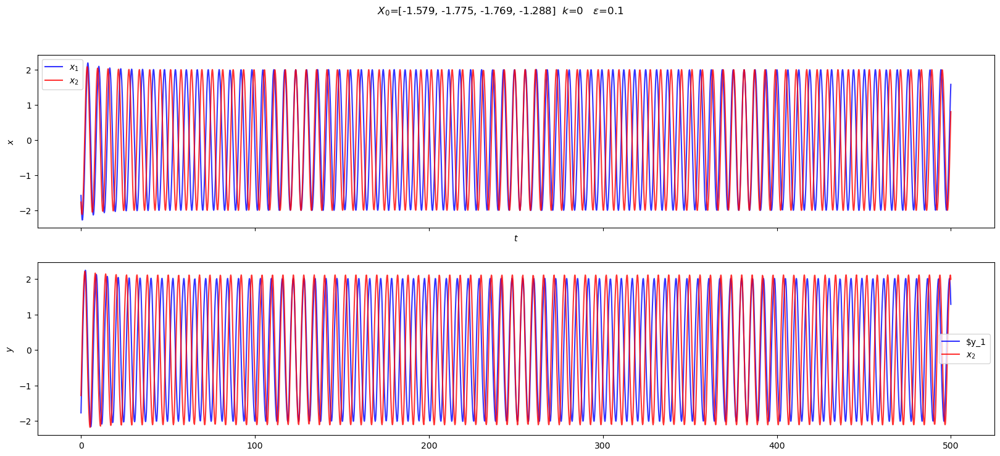

[-1.57936627 -1.77506473 -1.76941312 -1.28765386]
Phase difference of 107.41174070679675°


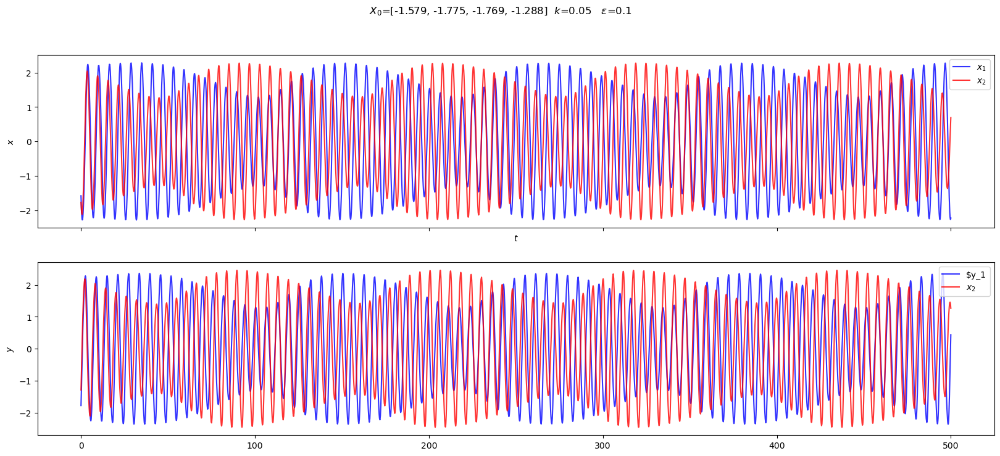

[-1.57936627 -1.77506473 -1.76941312 -1.28765386]
Phase difference of 21.958522228015532°


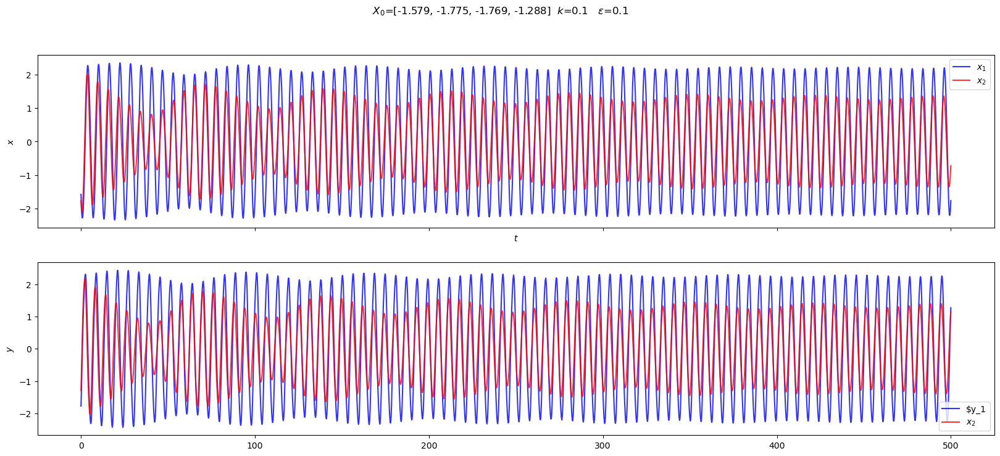

[-1.57936627 -1.77506473 -1.76941312 -1.28765386]
Phase difference of 0.3984754848680943°


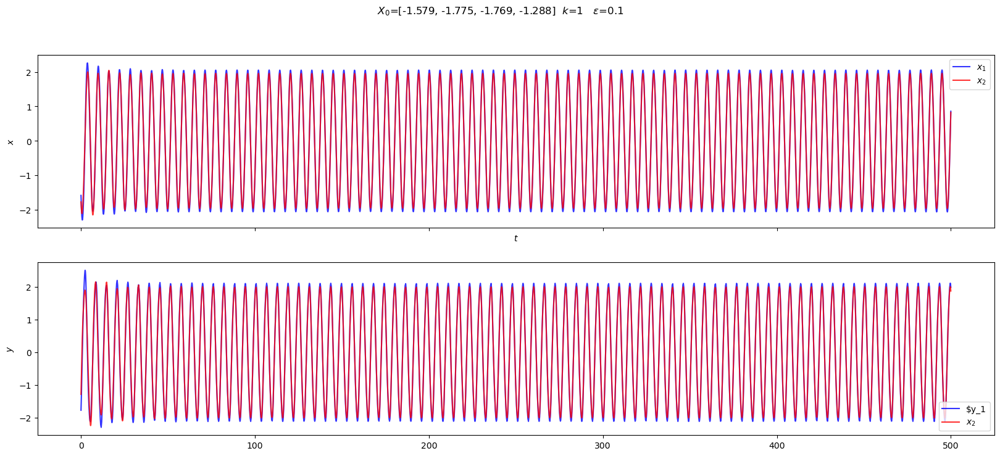

[-1.57936627 -1.77506473 -1.76941312 -1.28765386]
Phase difference of 0.11060907248355925°


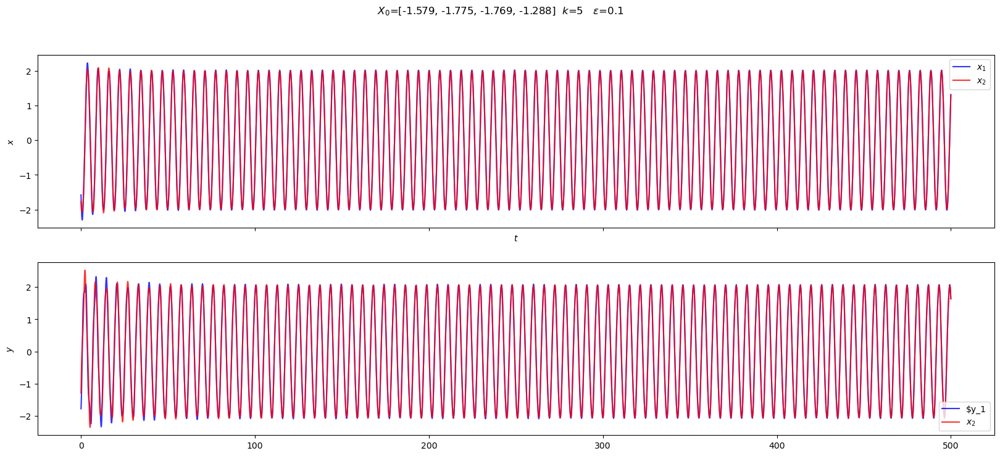

[ 0.82559944 -0.09948237  1.75697489 -1.90523646]
Phase difference of 4.953134139289438°


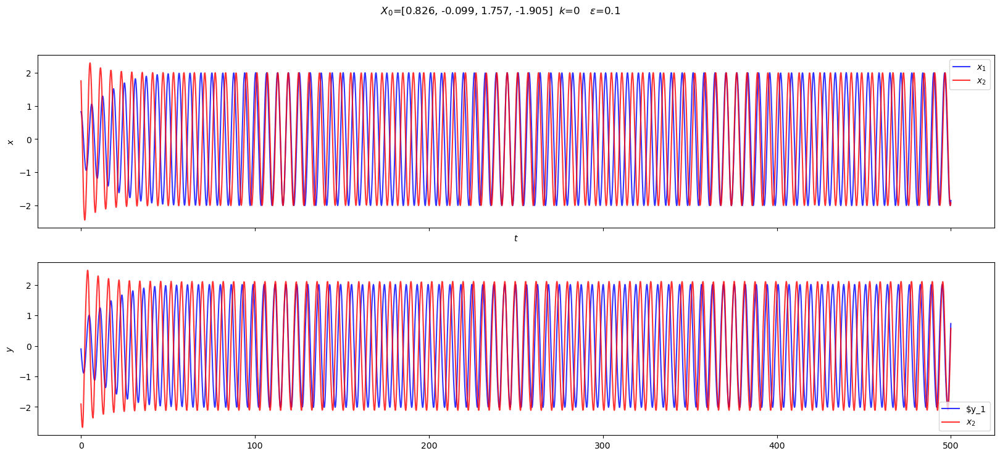

[ 0.82559944 -0.09948237  1.75697489 -1.90523646]
Phase difference of 200.2892478634108°


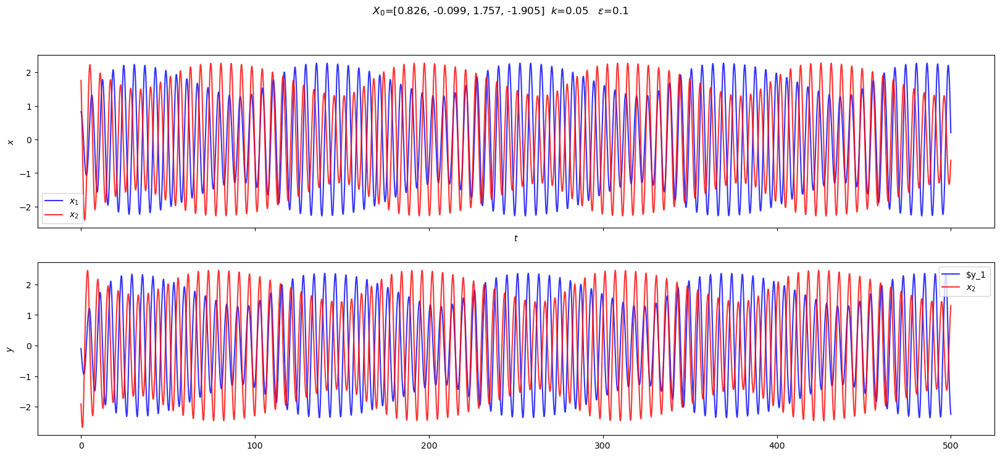

[ 0.82559944 -0.09948237  1.75697489 -1.90523646]
Phase difference of 193.46438512237492°


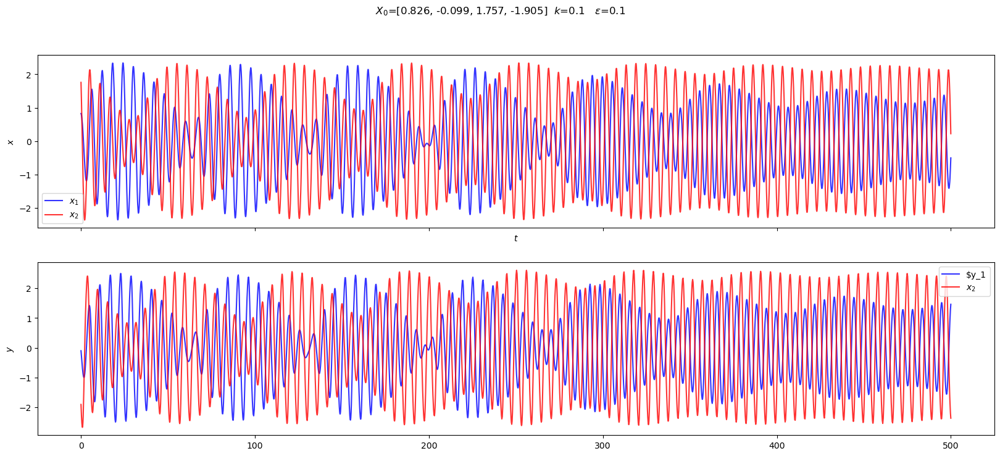

[ 0.82559944 -0.09948237  1.75697489 -1.90523646]
Phase difference of 0.10495103252921534°


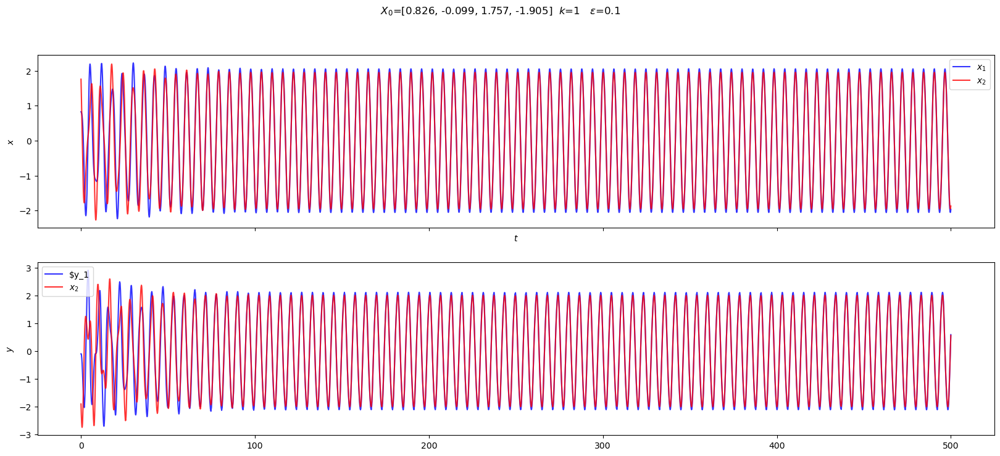

[ 0.82559944 -0.09948237  1.75697489 -1.90523646]
Phase difference of 0.005360395364293031°


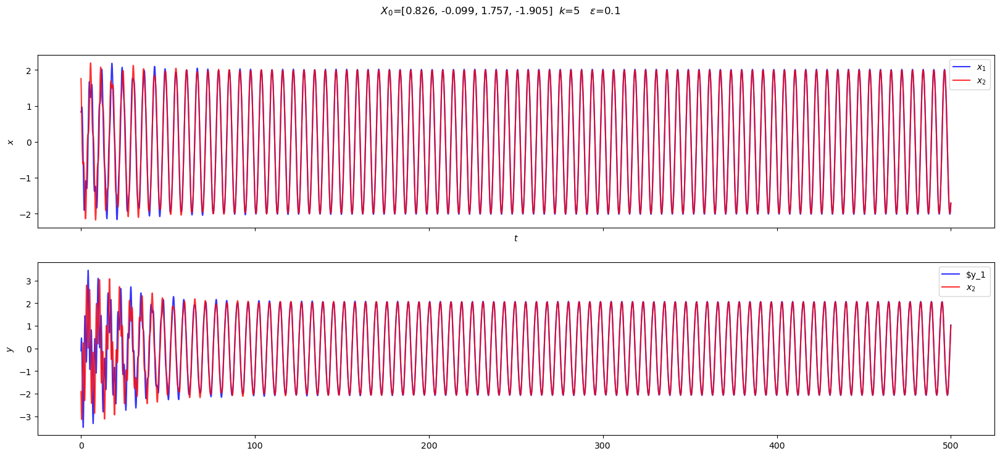

[-0.08297755  0.5195043  -2.33115512 -0.97315819]
Phase difference of 151.24388351230195°


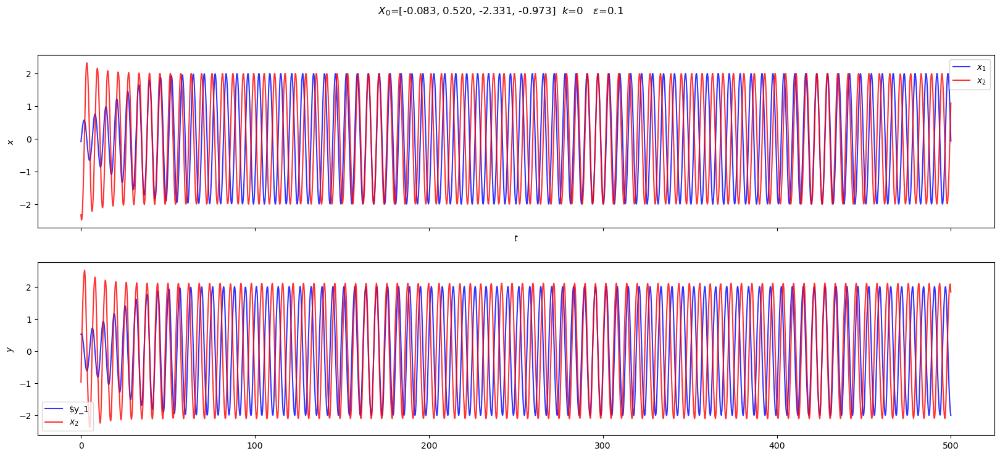

[-0.08297755  0.5195043  -2.33115512 -0.97315819]
Phase difference of 121.03195639648709°


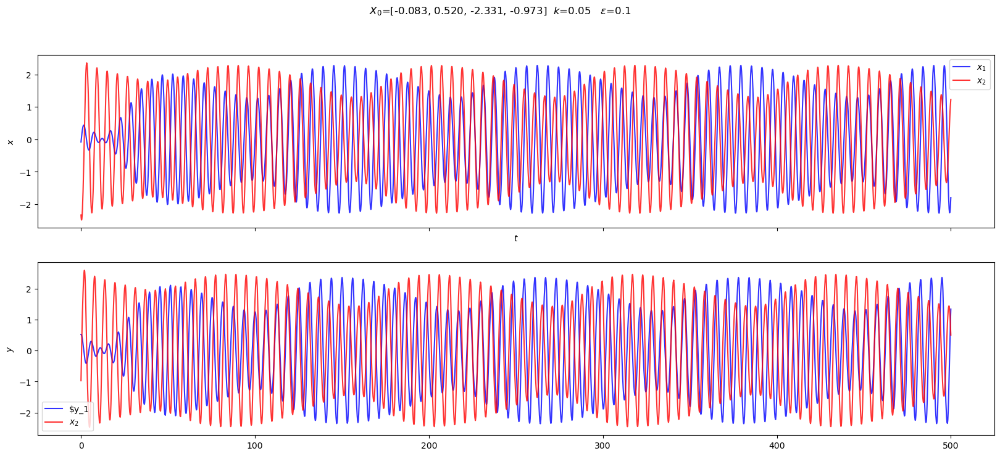

[-0.08297755  0.5195043  -2.33115512 -0.97315819]
Phase difference of 156.3227472182054°


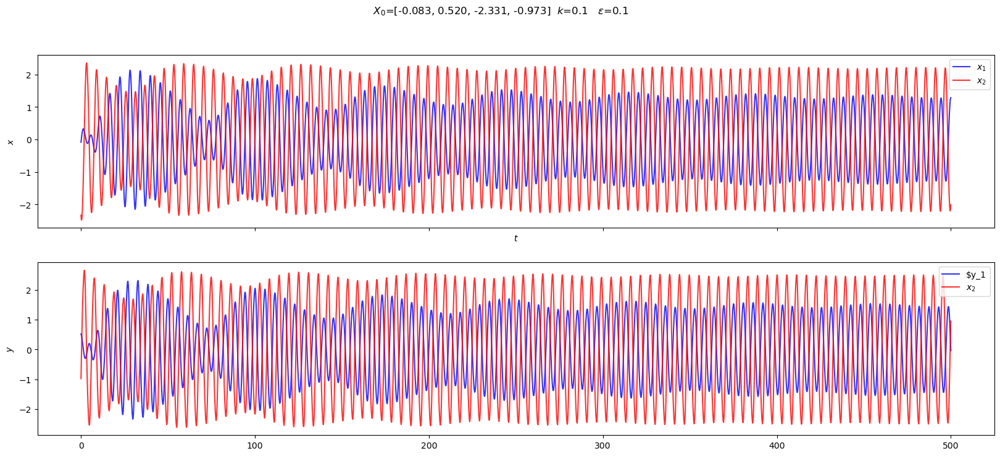

[-0.08297755  0.5195043  -2.33115512 -0.97315819]
Phase difference of 180.49167549354115°


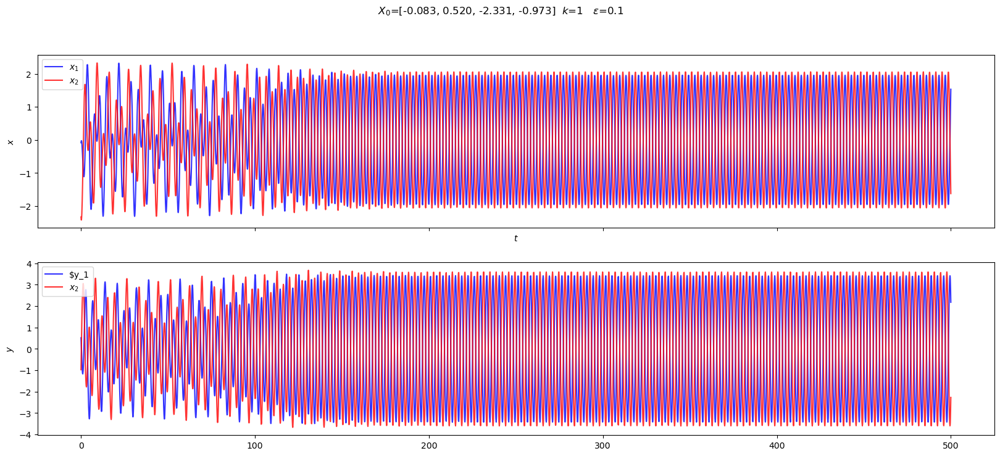

[-0.08297755  0.5195043  -2.33115512 -0.97315819]
Phase difference of 0.1740735133562552°


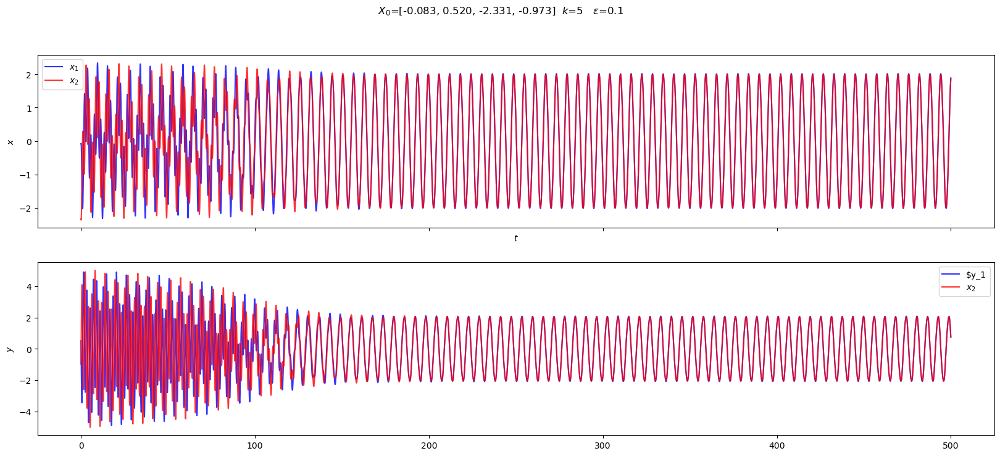

[-0.91544567  0.13945102  2.15245668 -2.14502129]
Phase difference of 190.55549707675857°


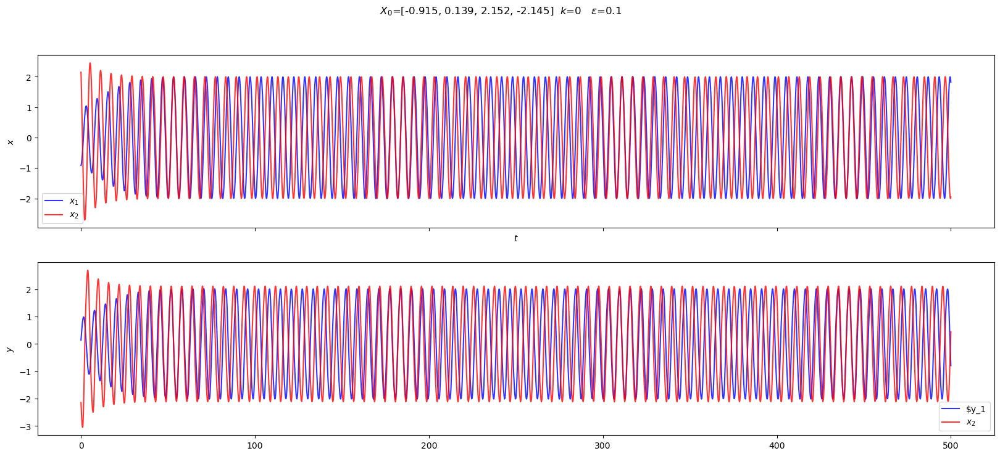

[-0.91544567  0.13945102  2.15245668 -2.14502129]
Phase difference of 87.8226474103447°


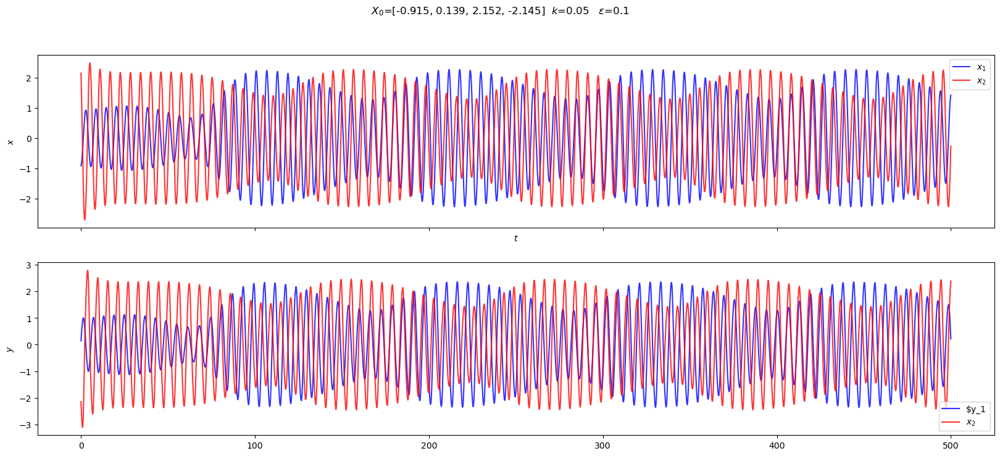

[-0.91544567  0.13945102  2.15245668 -2.14502129]
Phase difference of 199.44485980362197°


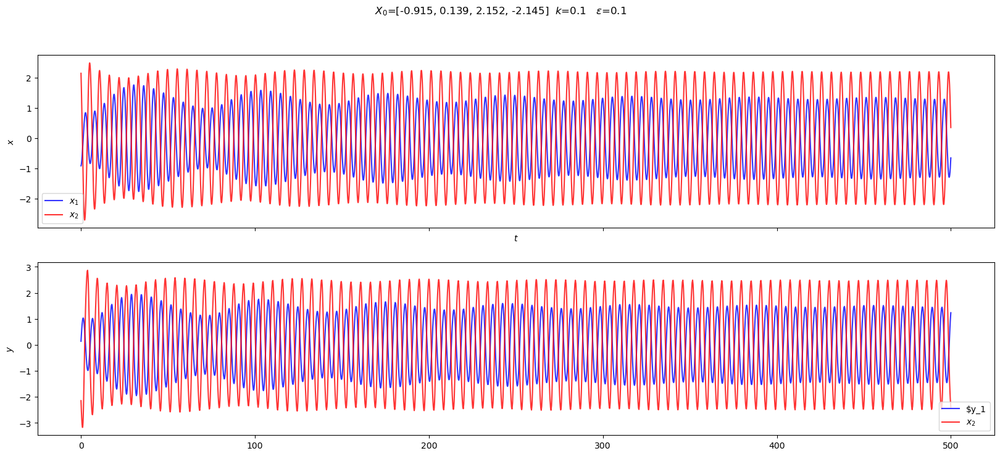

[-0.91544567  0.13945102  2.15245668 -2.14502129]
Phase difference of 180.97293557694863°


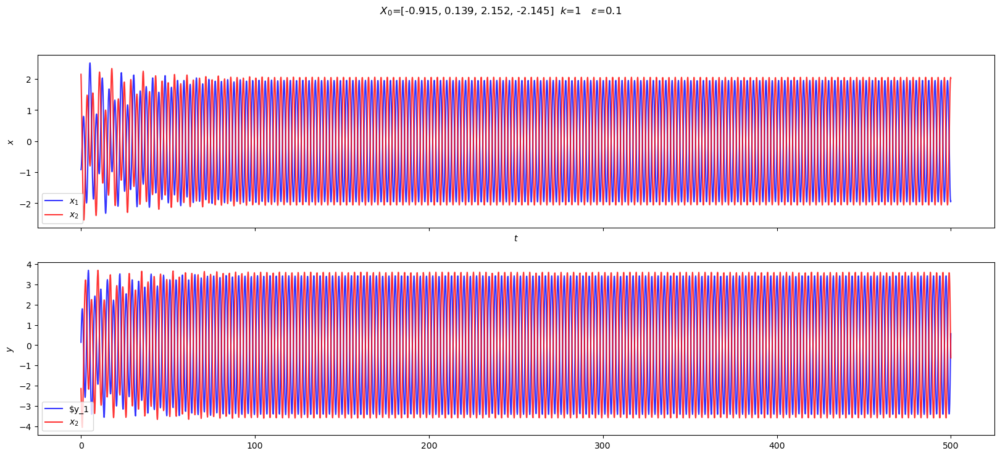

[-0.91544567  0.13945102  2.15245668 -2.14502129]
Phase difference of 179.89300035396437°


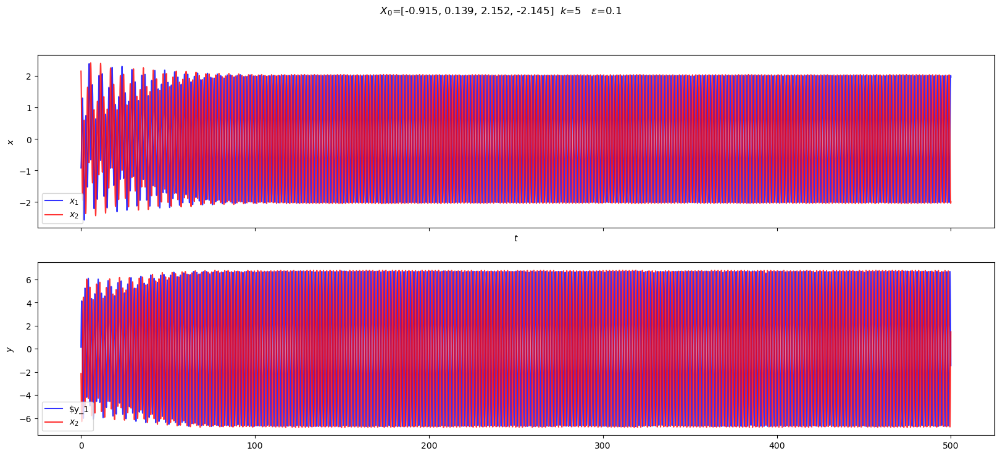

[ 0.87229031 -2.0570974   2.02764996 -2.15800245]
Phase difference of 62.29517716437531°


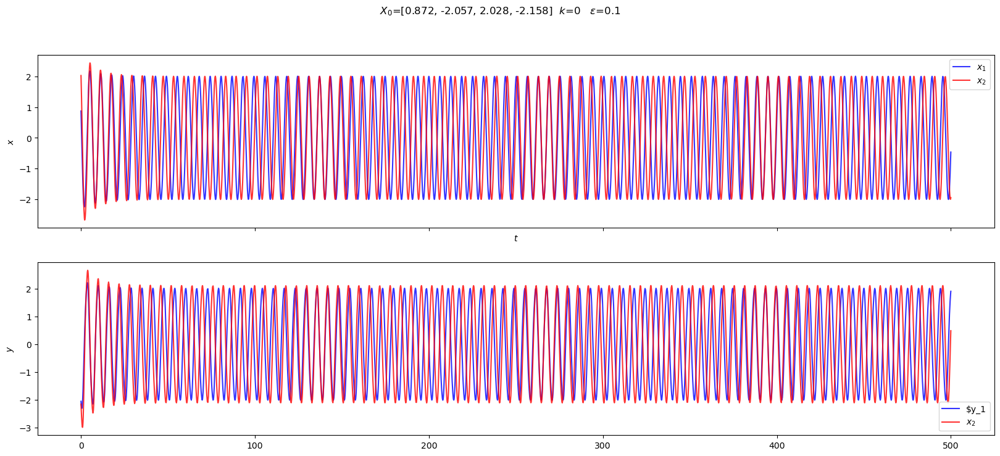

[ 0.87229031 -2.0570974   2.02764996 -2.15800245]
Phase difference of 275.35321714124495°


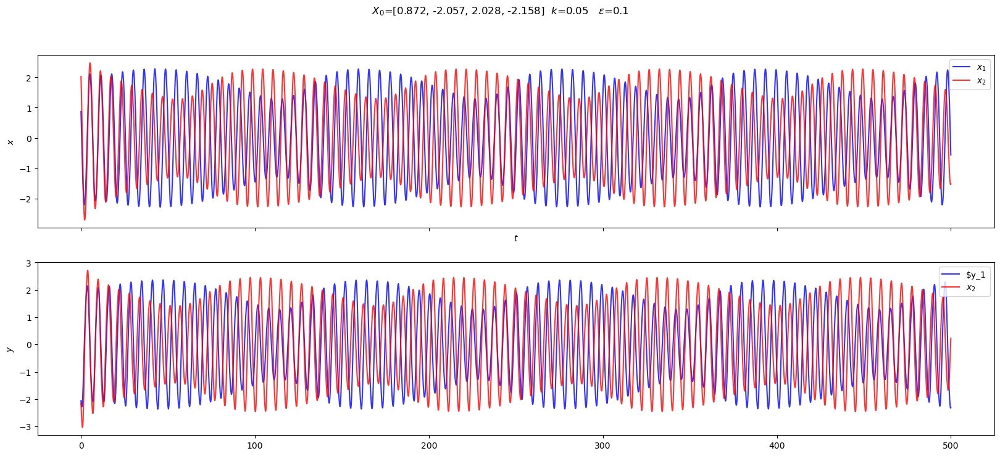

[ 0.87229031 -2.0570974   2.02764996 -2.15800245]
Phase difference of 21.421182125187073°


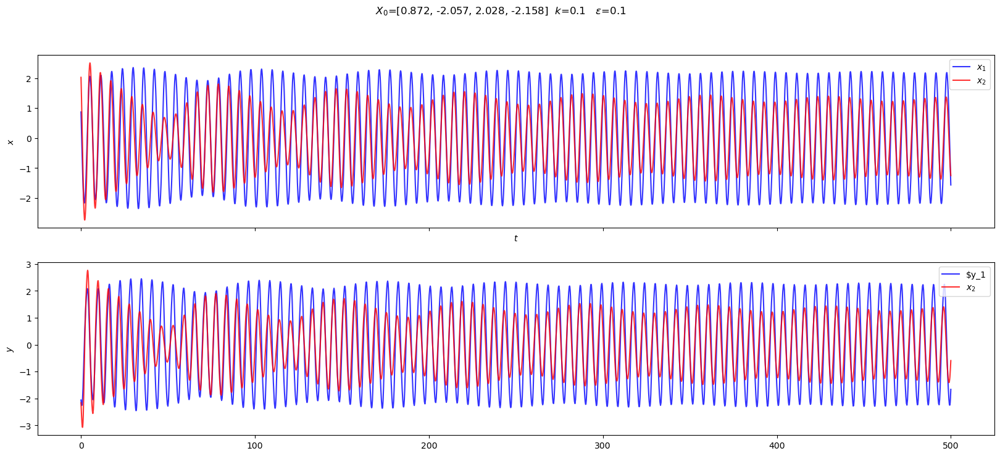

[ 0.87229031 -2.0570974   2.02764996 -2.15800245]
Phase difference of 0.28492282441188965°


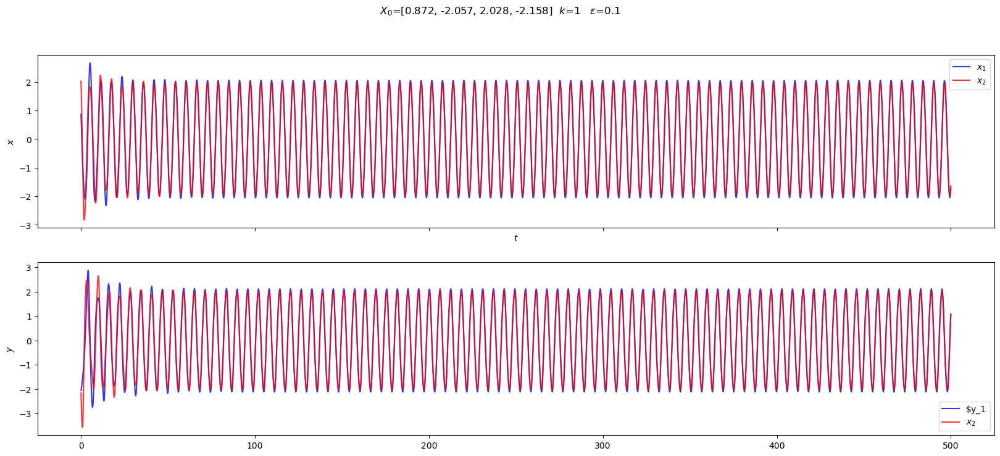

[ 0.87229031 -2.0570974   2.02764996 -2.15800245]
Phase difference of 0.06867048159867768°


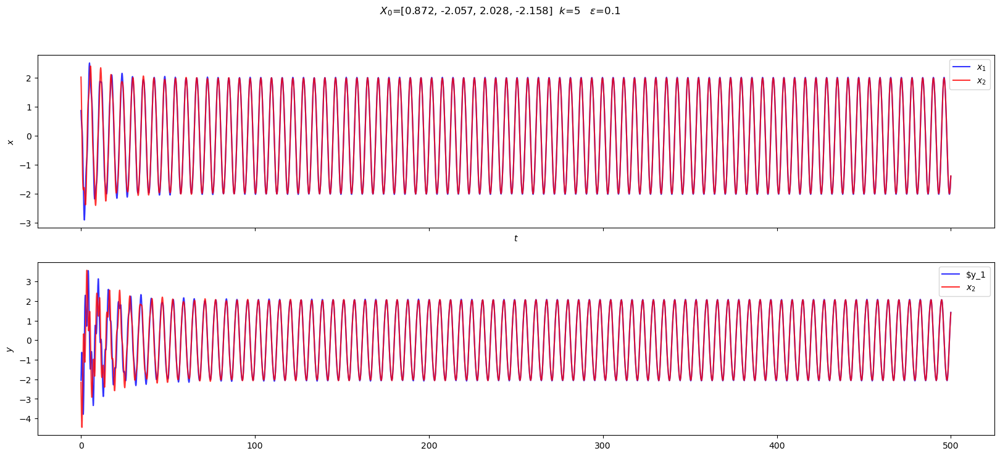

[ 1.58974591 -0.40454614  1.00467572  1.09549274]
Phase difference of 258.66918628173016°


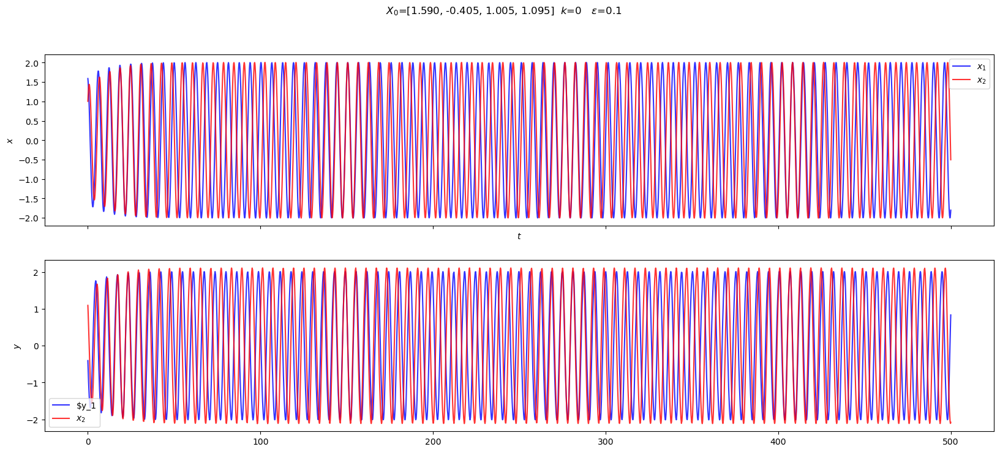

[ 1.58974591 -0.40454614  1.00467572  1.09549274]
Phase difference of 52.34477228733346°


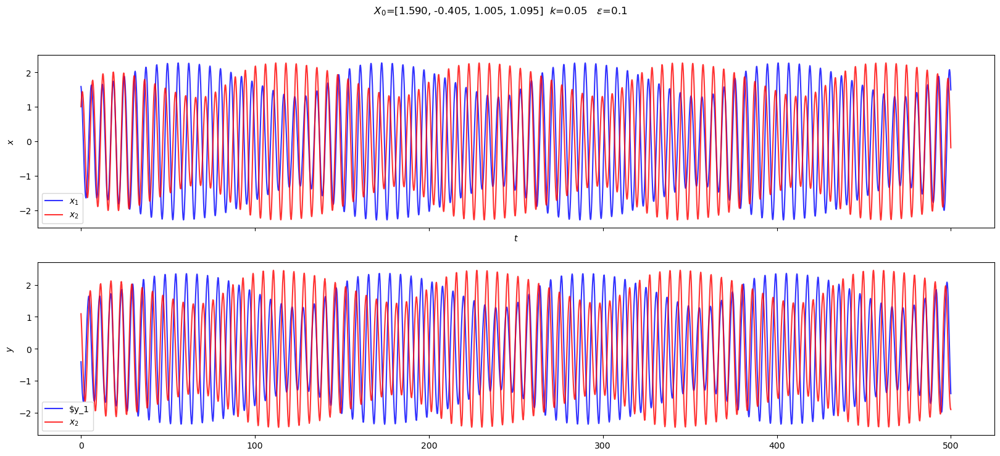

[ 1.58974591 -0.40454614  1.00467572  1.09549274]
Phase difference of 18.595915266386715°


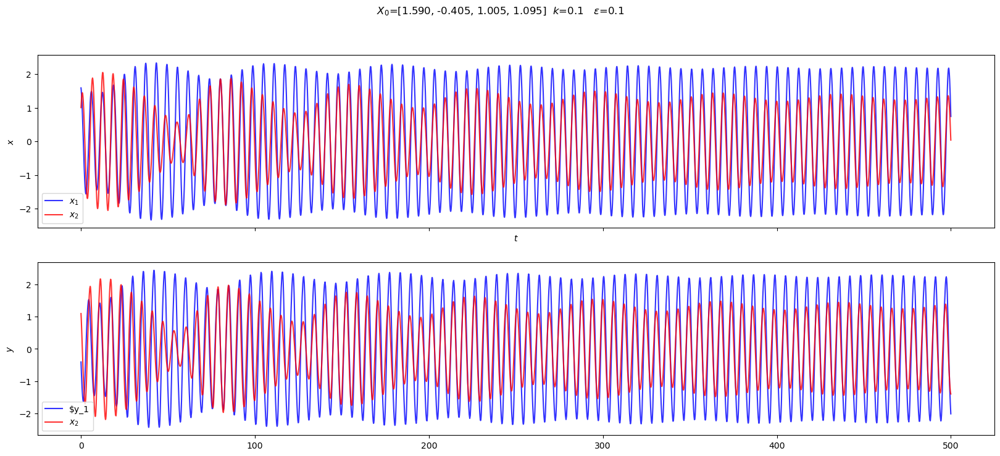

[ 1.58974591 -0.40454614  1.00467572  1.09549274]
Phase difference of 0.2862252407051331°


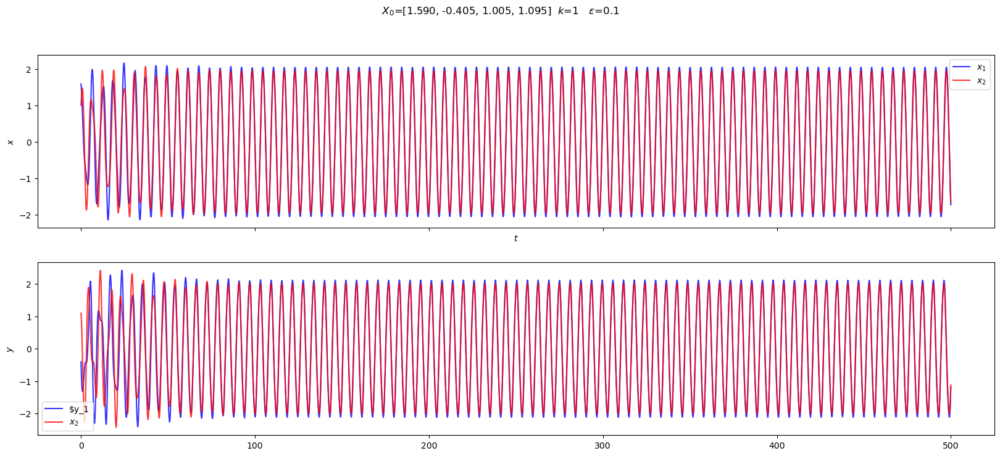

[ 1.58974591 -0.40454614  1.00467572  1.09549274]
Phase difference of 0.19780503267504465°


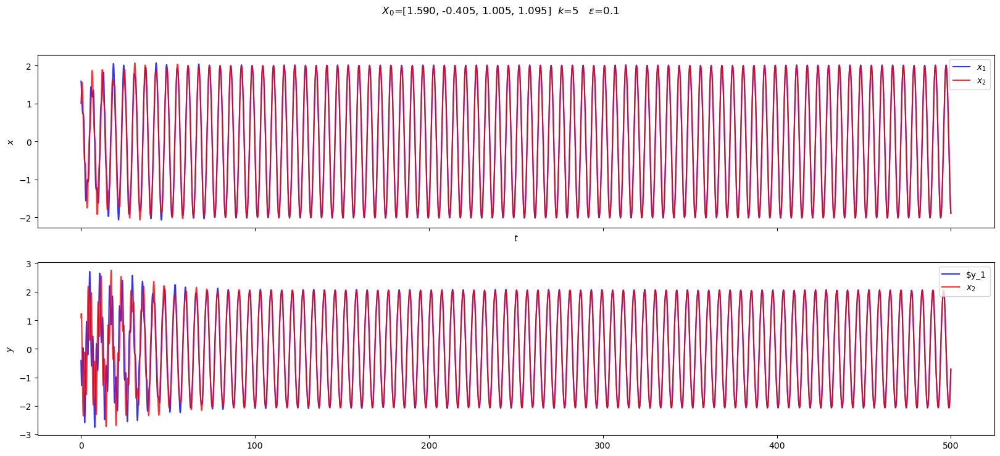

[ 1.92232732 -1.59262721  1.81888785  0.53056448]
Phase difference of 263.40155116360035°


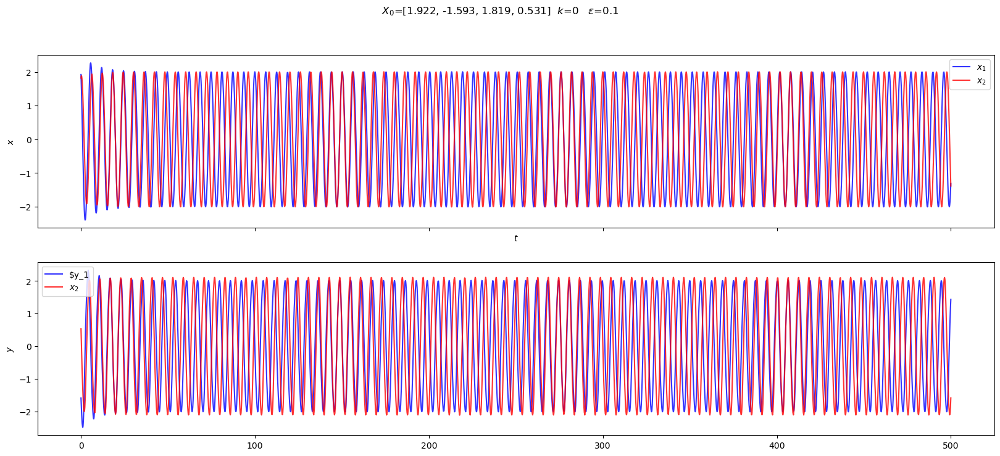

[ 1.92232732 -1.59262721  1.81888785  0.53056448]
Phase difference of 52.44484809921133°


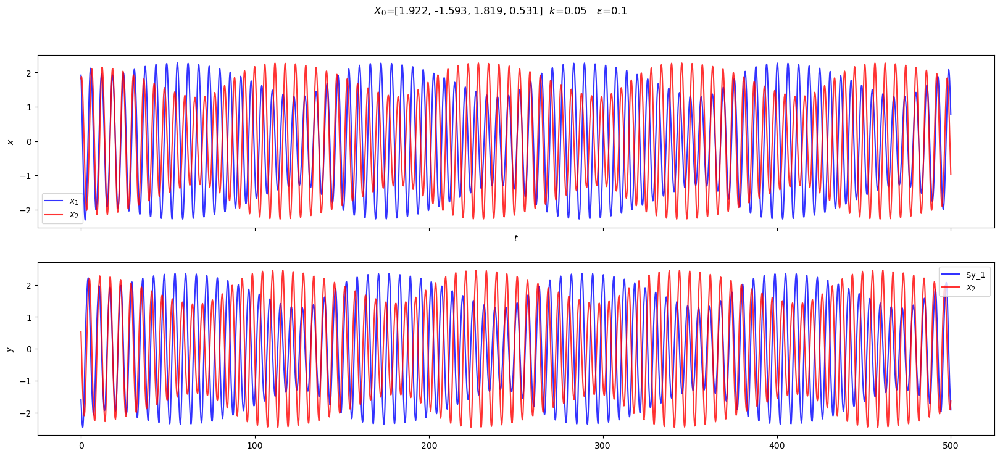

[ 1.92232732 -1.59262721  1.81888785  0.53056448]
Phase difference of 17.563848840615897°


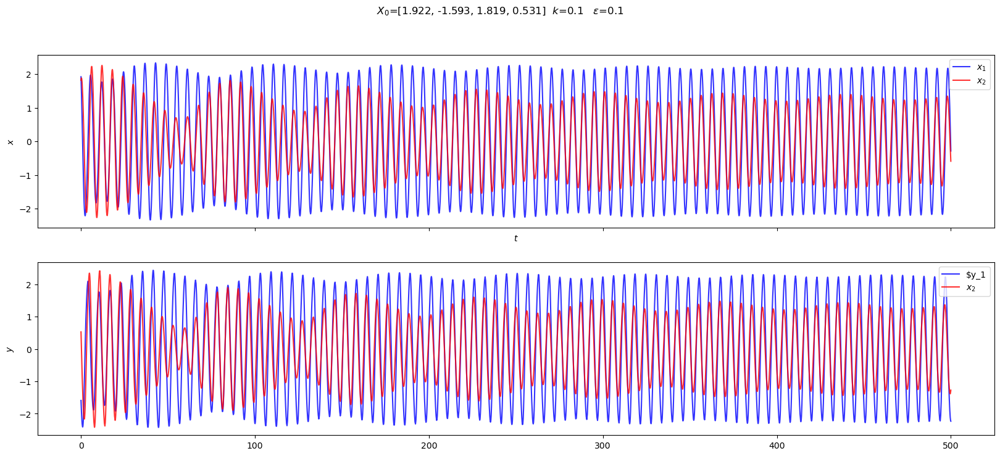

[ 1.92232732 -1.59262721  1.81888785  0.53056448]
Phase difference of 0.03148627738449022°


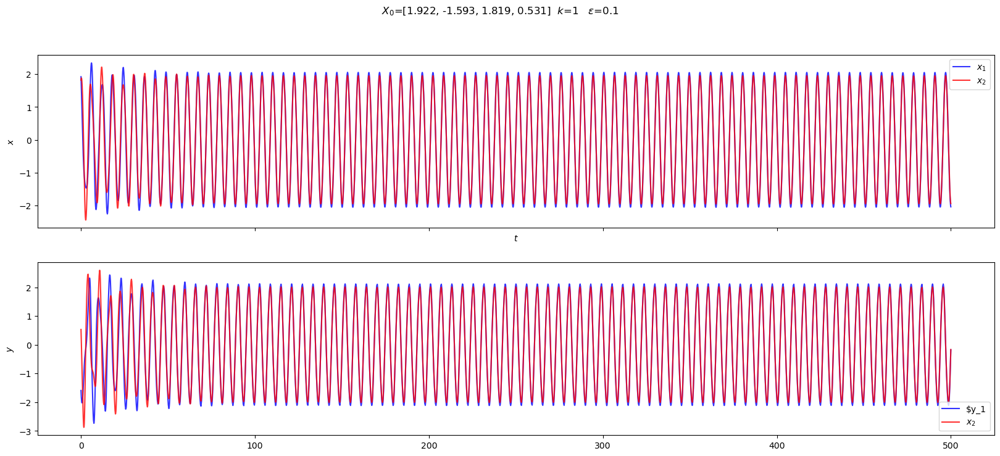

[ 1.92232732 -1.59262721  1.81888785  0.53056448]
Phase difference of 0.9050181107238763°


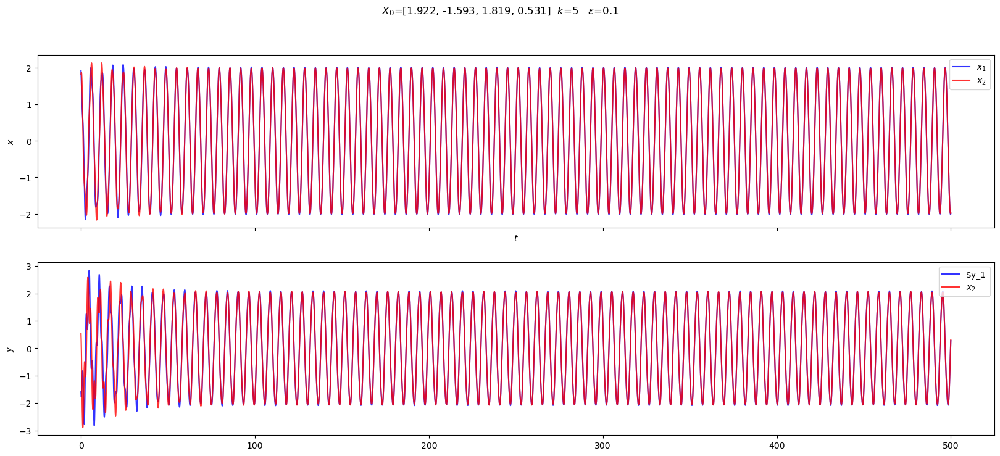

[-0.1962554  -1.72542513 -0.78950635 -0.86350359]
Phase difference of 2.9386129068149582°


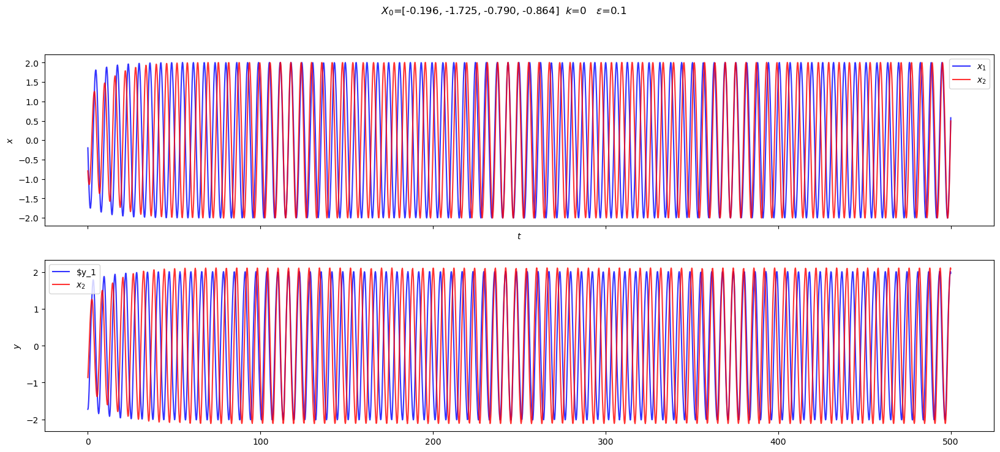

[-0.1962554  -1.72542513 -0.78950635 -0.86350359]
Phase difference of 207.18148358502864°


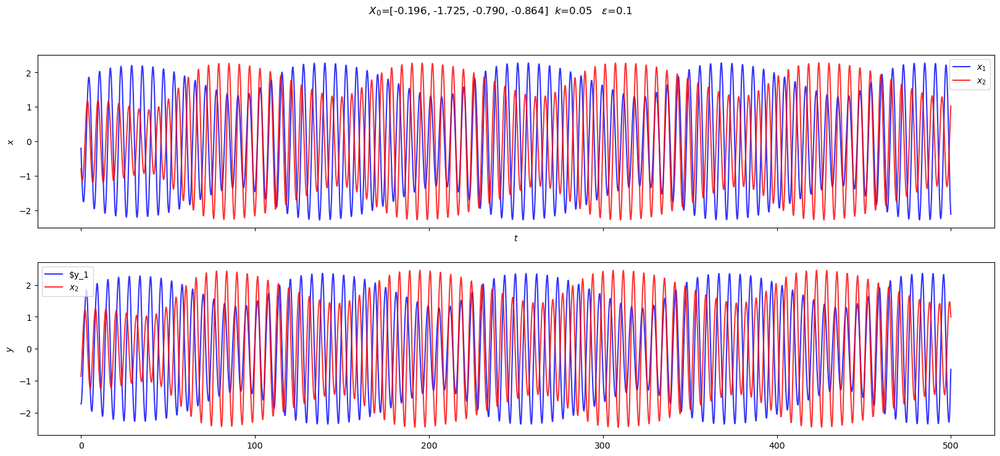

[-0.1962554  -1.72542513 -0.78950635 -0.86350359]
Phase difference of 20.155362024579123°


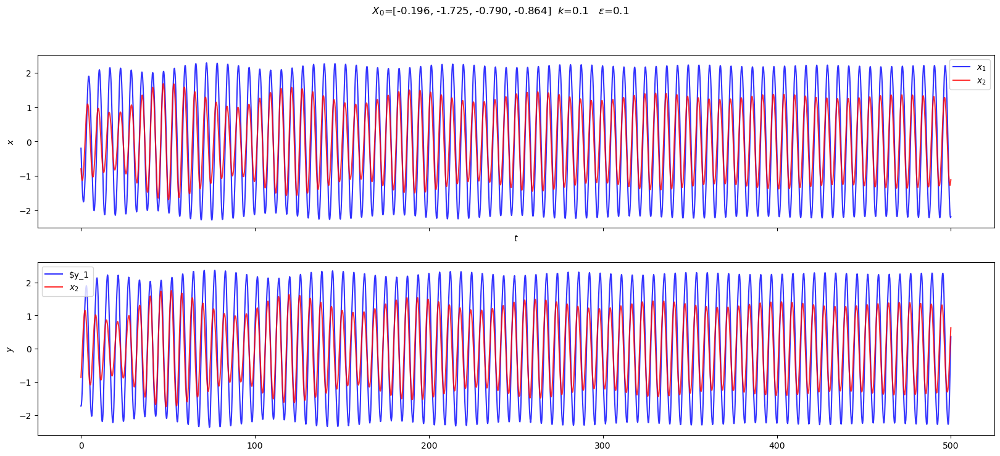

[-0.1962554  -1.72542513 -0.78950635 -0.86350359]
Phase difference of 0.3721684281347455°


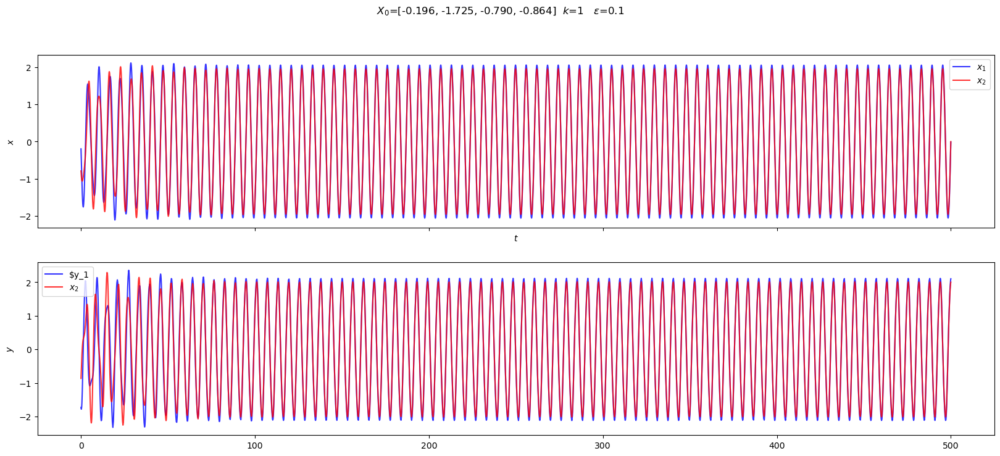

[-0.1962554  -1.72542513 -0.78950635 -0.86350359]
Phase difference of 0.03566780124794505°


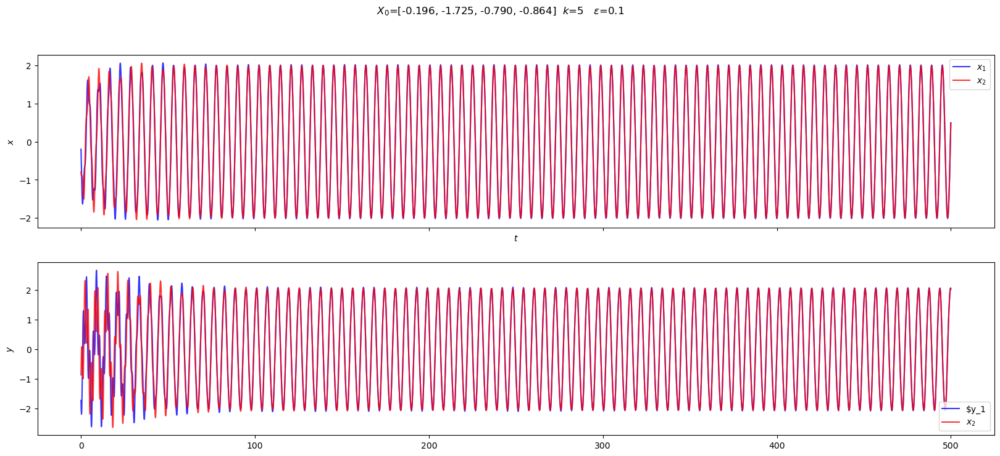

[-1.99797402  0.37552822  1.40215886 -1.34068845]
Phase difference of 185.270750062828°


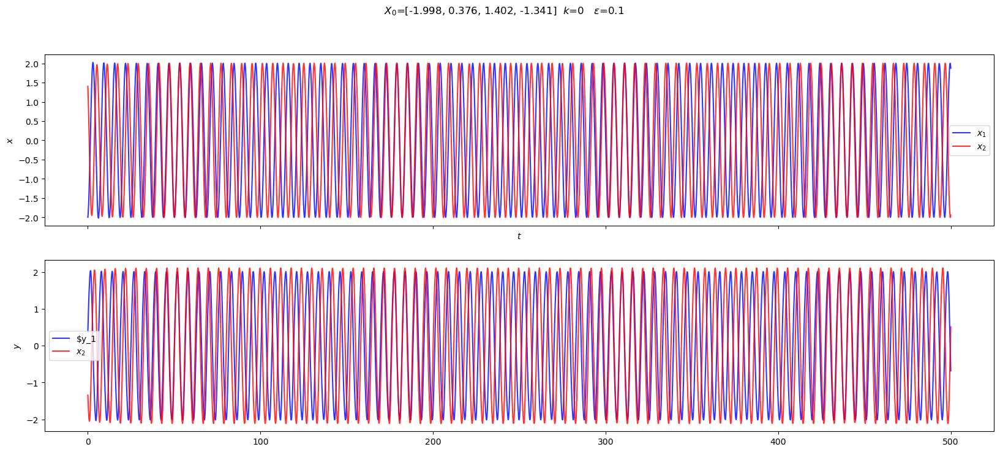

[-1.99797402  0.37552822  1.40215886 -1.34068845]
Phase difference of 30.441259732056622°


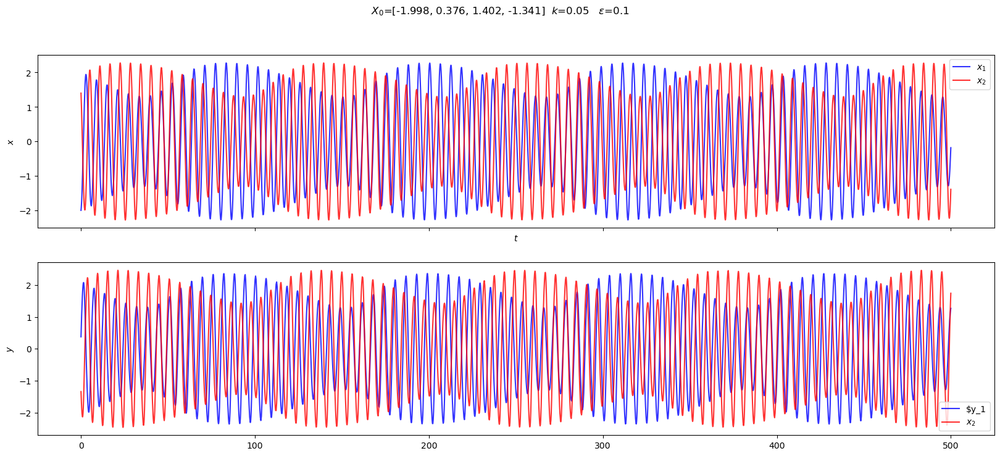

[-1.99797402  0.37552822  1.40215886 -1.34068845]
Phase difference of 202.14408404134545°


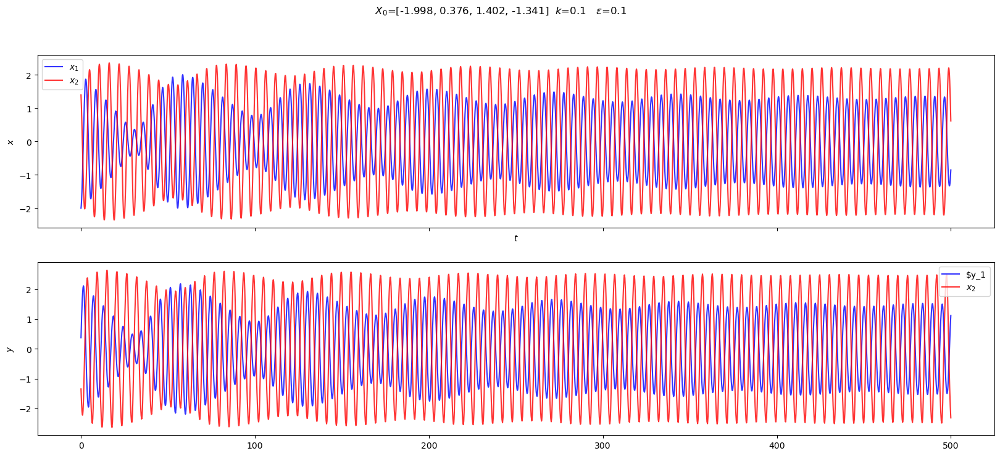

[-1.99797402  0.37552822  1.40215886 -1.34068845]
Phase difference of 181.05160756785008°


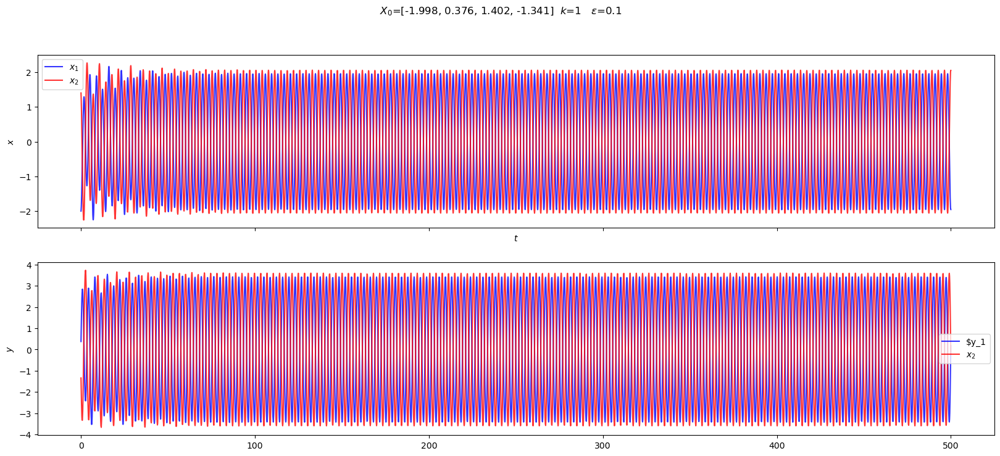

[-1.99797402  0.37552822  1.40215886 -1.34068845]
Phase difference of 179.8819042683772°


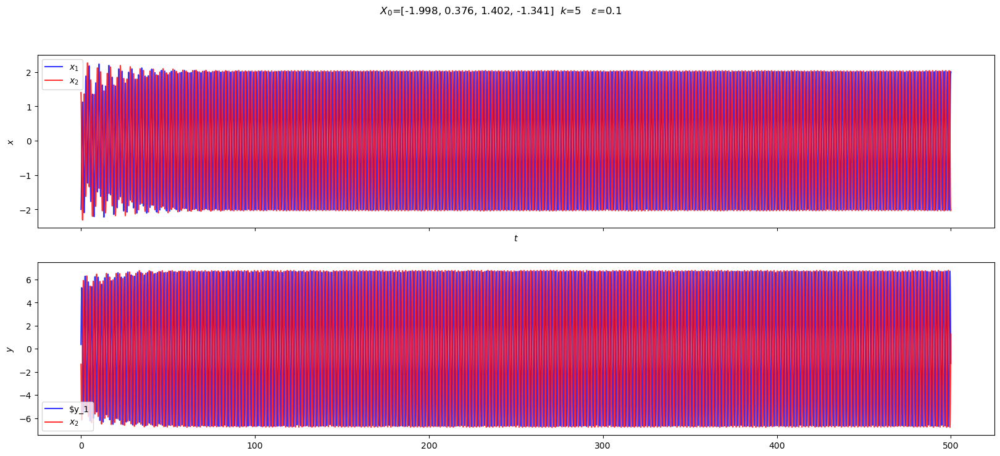

[ 0.46407832  1.48353066 -2.44421737  1.13738921]
Phase difference of 128.37133730302494°


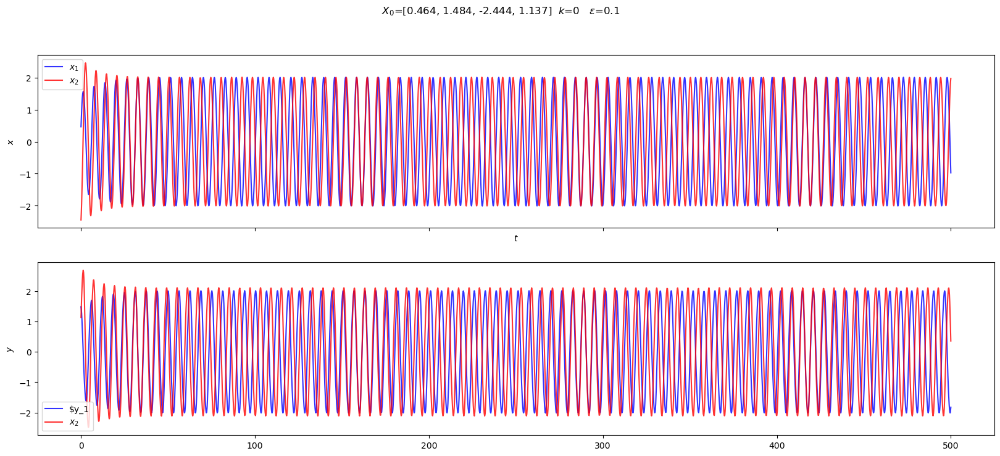

[ 0.46407832  1.48353066 -2.44421737  1.13738921]
Phase difference of 47.908681257572376°


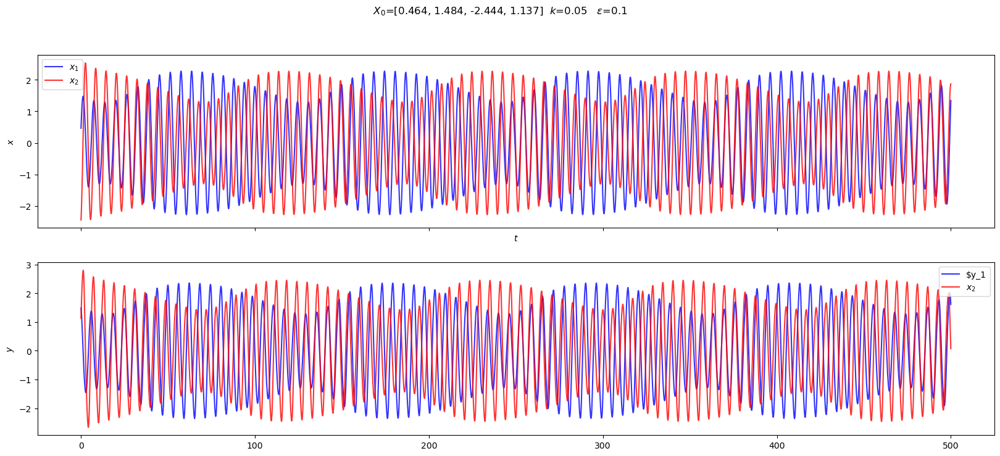

[ 0.46407832  1.48353066 -2.44421737  1.13738921]
Phase difference of 23.903502181908518°


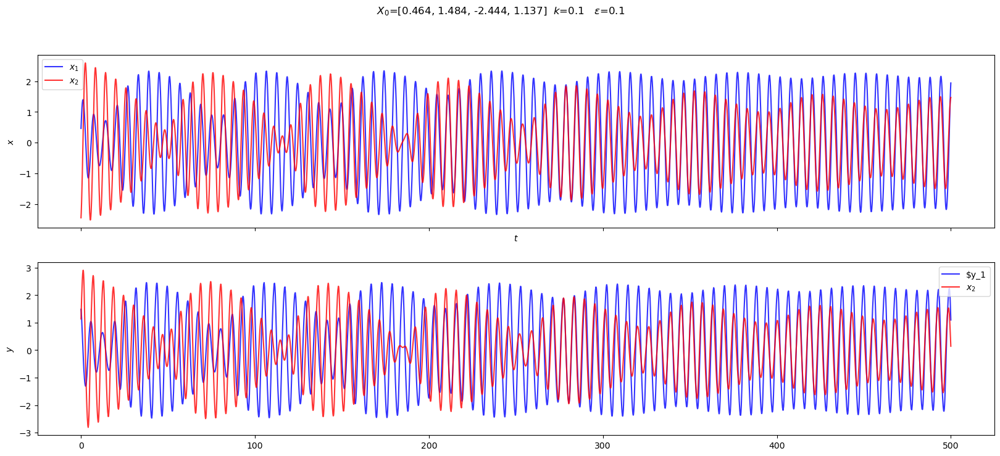

[ 0.46407832  1.48353066 -2.44421737  1.13738921]
Phase difference of 180.74615626051295°


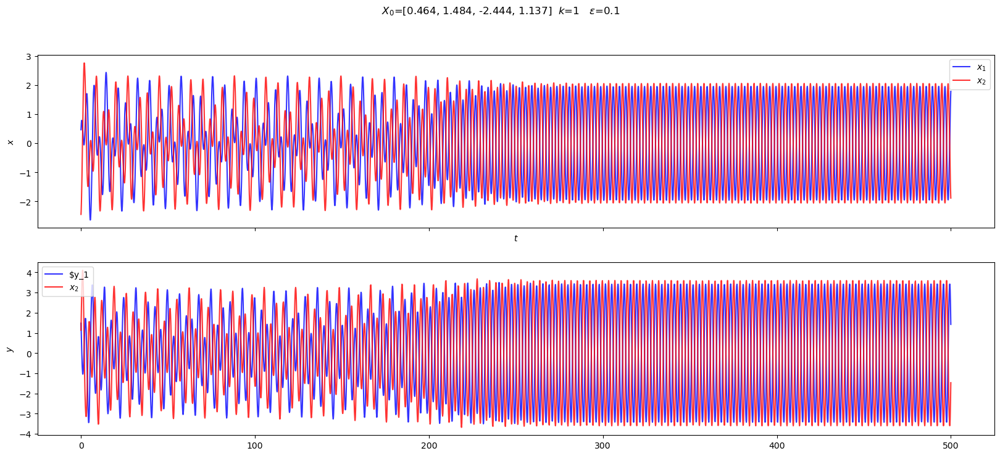

[ 0.46407832  1.48353066 -2.44421737  1.13738921]
Phase difference of 0.08072319092241038°


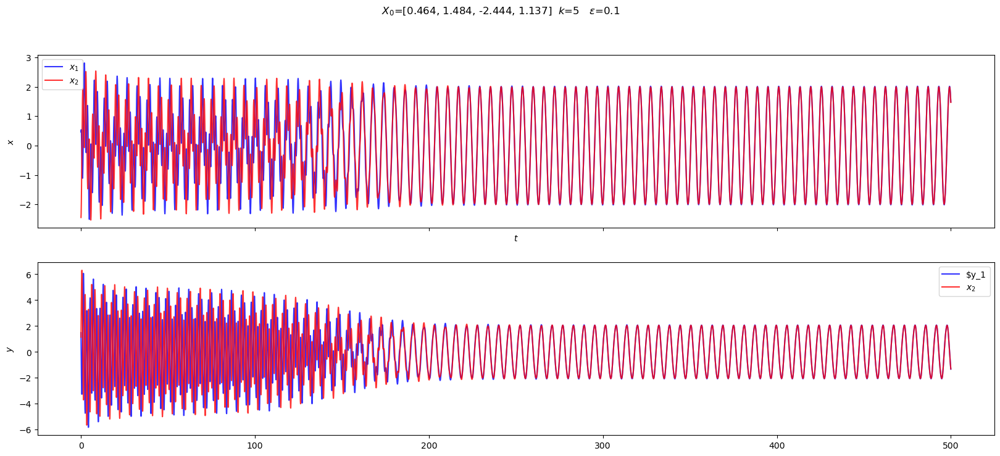

In [99]:
for i in range(len(X0)):
    dirname = f"X0=[{X0[i][0]:.3f},{X0[i][1]:.3f},{X0[i][2]:.3f},{X0[i][3]:.3f}]_ϵ={EPSILON}_{datetime.datetime.now()}"
    dirpath = os.path.join("figs/coupled_vdp", dirname)
    #os.mkdir(dirpath)
    for kappa in D_KAPPAS:
    
        print(X0[i])
        sol = solve_ivp(coupled_vdp_deriv,
                        [t_start, t_stop],
                        X0[i],
                        args=[EPSILON, kappa, DELTA_OMEGA],
                        method="LSODA",
                        dense_output=True)
        t = sol.t
        x1, y1, x2, y2 = sol.y

        '''
        rdata = np.zeros((500, 2))
        rdata[:,0] = x1[-500:]
        rdata[:,1] = y1[-500:]
        scaler = StandardScaler()
        scaler.fit(rdata)
        data = scaler.transform(rdata)


        c = np.cov(np.transpose(data))
        phi = np.arccos(c[0,1])
        print(f"Phase difference of {np.rad2deg(phi)}°")

        #print(rdata)
        '''

        
        z1 = x1[-1] + y1[-1]*1j
        z2 = x2[-1] + y2[-1]*1j
        ph1 = np.angle(z1)
        ph2 = np.angle(z2)
        delta_ph = np.abs(ph2-ph1)
        print(f"Phase difference of {np.rad2deg(delta_ph)}°")
        

        fig, axes = plt.subplots(nrows=2, ncols=1, sharex=True, figsize=(20, 8))
        #axes[0].set_ylim(-0.3, 10)
        axes[0].set_ylabel("$x$")
        axes[0].set_xlabel("$t$")
        axes[0].plot(t, x1, label="$x_1$", color=colors[0], alpha=0.8)
        axes[0].plot(t, x2, label="$x_2$", color=colors[1], alpha=0.8)
        axes[0].legend()

        axes[1].set_ylabel("$y$")
        axes[1].plot(t, y1, label="$y_1$", color=colors[0], alpha=0.8)
        axes[1].plot(t, y2, label="$x_2$", color=colors[1], alpha=0.8)
        axes[1].legend()

        fig.suptitle(f"$X_0$=[{X0[i][0]:.3f}, {X0[i][1]:.3f}, {X0[i][2]:.3f}, {X0[i][3]:.3f}]  $k$={kappa}   $\epsilon$={EPSILON}")

        #plt.savefig(os.path.join(dirpath, f"k={kappa}_X0=[{X0[i][0]:.3f},{X0[i][1]:.3f},{X0[i][2]:.3f},{X0[i][3]:.3f}]_ϵ={EPSILON}.png"), dpi=300, format='png', transparent=False)

        plt.show()


[-1.284, 0.446, -0.533, -1.971]


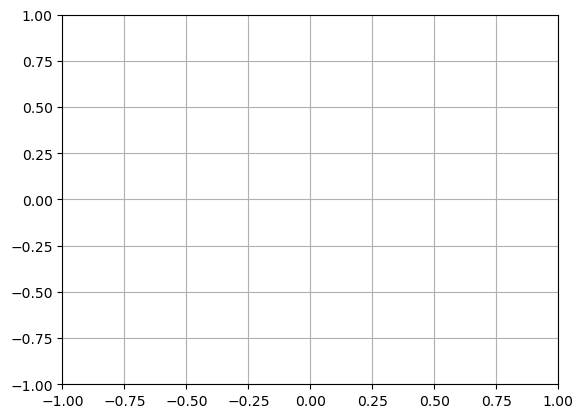

In [55]:
STRT_MAX = 5
init_phase1 = random.random()*2*np.pi
init_phase2 = random.random()*2*np.pi
x0 = [np.cos(init_phase1), np.sin(init_phase1), np.cos(init_phase2), np.sin(init_phase2)]

x0 = [-1.284, 0.446, -0.533, -1.971]

print(x0)
plt.scatter(x0[0], x0[1])
plt.scatter(x0[2], x0[3])
plt.ylim(-1, 1)
plt.xlim(-1, 1)
plt.grid()
plt.show()
#x0 = ((np.random.rand(1, 4)[0])-0.5)*STRT_MAX

In [4]:
def biggest_freq(xf, yf):
    amplitudes = np.abs(yf)
    maxIndex = 0
    for i in range(len(yf)):
        if amplitudes[i] > amplitudes[maxIndex]:
            maxIndex = i

    return (xf[maxIndex], yf[maxIndex])
    

In [5]:
def vdp_deriv(t, X, eps):
    x1, y1 = X
    return [y1, -eps*(x1*x1 - 1)*y1 - x1]

def event_vdp(t, X, eps):
    dXdt = vdp_deriv(t, X, eps)
    return dXdt[0]

event_vdp.direction = -1

def coupled_vdp_deriv(t, X, eps, k, domega):
    x1, y1, x2, y2 = X
    return [y1, -eps*(x1*x1 - 1)*y1 - x1 + k*(x2 - x1), y2, -eps*(x2*x2 - 1)*y2 - (1+domega)*x2 + k*(x1 - x2)]


# integrator will tell us when the return value of the event vanishes, can be used for roots, turning points etc.
def event0(t, X, eps, k, domega):
    dXdt = coupled_vdp_deriv(t, X, eps, k, domega)
    return dXdt[0] # dx1 = 0 find maxima for x1
    #return X[0]

event0.direction = -1 # will give us the maxima

def event1(t, X, eps, k, domega):
    dXdt = coupled_vdp_deriv(t, X, eps, k, domega)
    return dXdt[2] # dx2 = 0 find maxima for x2

event1.direction = -1 # will give us the maxima

t then y events
  message: 'The solver successfully reached the end of the integration interval.'
     nfev: 5090
     njev: 60
      nlu: 60
      sol: <scipy.integrate._ivp.common.OdeSolution object at 0x139490460>
   status: 0
  success: True
        t: array([0.00000000e+00, 1.00000333e-03, 2.00000667e-03, ...,
       2.99998000e+02, 2.99999000e+02, 3.00000000e+02])
 t_events: [array([  2.68415411,   8.6634452 ,  14.52095439,  18.51563121,
        23.88366059,  29.7834986 ,  35.71676612,  41.68609964,
        47.68191785,  53.68765252,  59.69578495,  65.70538983,
        71.71636079,  77.7260674 ,  83.71960567,  89.37848834,
        92.89545421,  98.79857971, 104.74121161, 110.70376844,
       116.70021251, 122.71683116, 128.74492662, 134.78651159,
       140.84947515, 146.9576295 , 153.17491009, 159.8609885 ,
       167.02948423, 173.36545484, 179.50096026, 185.61731524,
       191.75427209, 197.92160894, 204.12503671, 210.37089239,
       216.65861385, 222.97621137, 229.30135402,

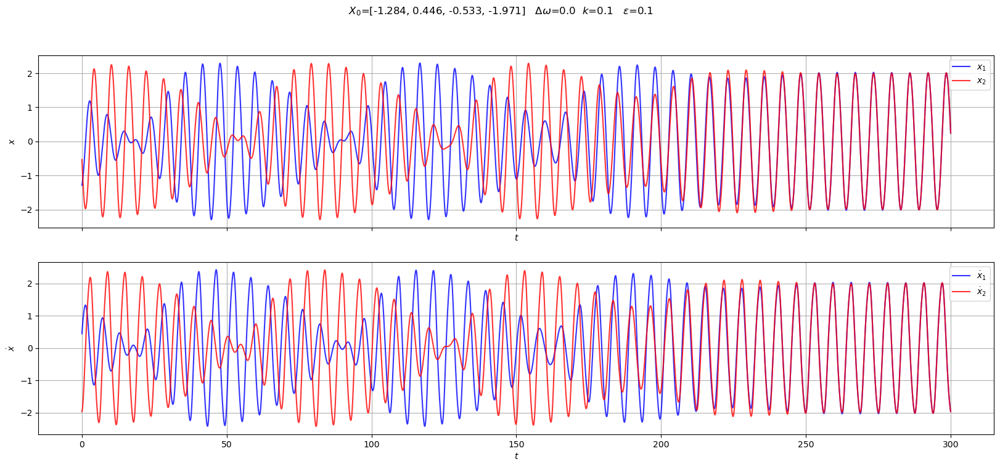

x1 has frequency of 0.16
x2 has frequency of 0.16


'\nx1_freq_sig = 2*np.sin(x1_freq*2*np.pi*t)\n\nfig, axes = plt.subplots(nrows=1, ncols=1, figsize=(20, 8))\naxes.plot(t, x1, color="blue")\naxes.plot(t, x1_freq_sig, color="orange", alpha=0.5)\nplt.show()\n'

In [57]:

t_start = 0
t_stop = 300
DURATION = t_stop
SAMPLE_RATE = 1000

EPSILON = 0.1
KAPPA = 0.1
DELTA_OMEGA = 0.
colors = ["blue", "red"]

SAMPLES = int(DURATION*SAMPLE_RATE)
t = np.linspace(t_start, t_stop, SAMPLE_RATE*DURATION)
sol = solve_ivp(coupled_vdp_deriv,
                        [t_start, t_stop],
                        x0,
                        args=[EPSILON, KAPPA, DELTA_OMEGA],
                        method="LSODA",
                        dense_output=True,
                        t_eval=t,
                        events=[event0, event1])

#t = sol.t
x1, y1, x2, y2 = sol.y

print("t then y events")
print(sol)
print(sol.t_events)#, len(sol.t_events[0]))
print(sol.y_events)#, len(sol.y_events.shape[0]))


fig, axes = plt.subplots(nrows=2, ncols=1, sharex=True, figsize=(20, 8))
#axes[0].set_ylim(-0.3, 10)
axes[0].set_ylabel("$x$")
axes[0].set_xlabel("$t$")
axes[0].plot(t, x1, label="$x_1$", color=colors[0], alpha=0.8)
axes[0].plot(t, x2, label="$x_2$", color=colors[1], alpha=0.8)
#axes[0].scatter(sol.t_events[0], [0 for e in sol.t_events[0]], zorder=10, color="green")
#axes[0].scatter(sol.t_events[1], [0 for e in sol.t_events[1]], zorder=10, color="purple")
axes[0].legend()
axes[0].grid(axis="both")

axes[1].set_ylabel("$\dot{x}$")
axes[1].set_xlabel("$t$")
axes[1].plot(t, y1, label="$\dot{x}_1$", color=colors[0], alpha=0.8)
axes[1].plot(t, y2, label="$\dot{x}_2$", color=colors[1], alpha=0.8)
axes[1].legend()
axes[1].grid(axis="both")

#plt.grid(axis="both")

fig.suptitle(f"$X_0$=[{x0[0]:.3f}, {x0[1]:.3f}, {x0[2]:.3f}, {x0[3]:.3f}]   $\Delta \omega$={DELTA_OMEGA}  $k$={KAPPA}   $\epsilon$={EPSILON}")
plt.savefig(os.path.join("figs/coupled_phaseplot", f"X0=[{x0[0]:.3f},{x0[1]:.3f},{x0[2]:.3f},{x0[3]:.3f}]_k={KAPPA}_ϵ={EPSILON}_domega={DELTA_OMEGA}_duration={DURATION}.png"), dpi=300, format='png', transparent=False)
plt.show()

#phase_diff = stable_phase_diff(x1, x2, y1, y2)
#print(f"Phase difference of {np.rad2deg(phase_diff)}°")


FFT_SAMPLES = SAMPLES#SAMPLE_RATE*DURATION//2

# only use the last 500 datapoints, once the oscillator enters stable regime
yf1 = rfft(x1[-FFT_SAMPLES:])
xf1 = rfftfreq(FFT_SAMPLES, 1 / SAMPLE_RATE)

yf2 = rfft(x2[-FFT_SAMPLES:])
xf2 = rfftfreq(FFT_SAMPLES, 1 / SAMPLE_RATE)

'''
plt.plot(xf1, np.abs(yf1))
plt.show()

plt.plot(xf2, np.abs(yf2))
plt.show()
'''


x1_freq = biggest_freq(xf1, yf1)[0]
print(f"x1 has frequency of {x1_freq}")

x2_freq = biggest_freq(xf2, yf2)[0]
print(f"x2 has frequency of {x2_freq}")

'''
x1_freq_sig = 2*np.sin(x1_freq*2*np.pi*t)

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(20, 8))
axes.plot(t, x1, color="blue")
axes.plot(t, x1_freq_sig, color="orange", alpha=0.5)
plt.show()
'''

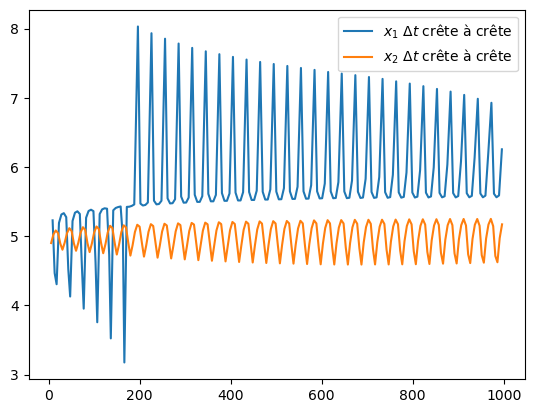

time frequency of x1 signal 0.16693662507091286
time frequency of x2 signal 0.2030138605427193
172
[5.22949775 4.46703264 4.30606542 5.19222422 5.3141452  5.3331223
 5.27594892 4.5247727  4.12863922 5.2198477  5.33958548 5.36000427
 5.3213485  4.56185288 3.95319499 5.26705586 5.36421383 5.38303126
 5.36247847 4.62170732 3.75652597 5.32056895 5.38776255 5.40350627
 5.3977569  4.72894756 3.52332    5.37443682 5.40833715 5.42174397
 5.42993945 4.96265231 3.17530982 5.4239252  5.4265231  5.43801367
 5.45962777 8.03114463 5.47177649 5.4438426  5.45198169 5.48732297
 7.93365629 5.51362009 5.46052217 5.46558406 5.51243955 7.85441296
 5.54727471 5.47394045 5.47701061 5.53505592 7.78463081 5.5734059
 5.48457545 5.48679432 5.55865727 7.72201475 5.59841896 5.49600564
 5.49614196 5.57835032 7.67226563 5.61224046 5.50433359 5.5043818
 5.5974562  7.63074408 5.62336441 5.5114992  5.51166015 5.61748452
 7.59182952 5.63047297 5.51673218 5.51695608 5.63722141 7.55319278
 5.63890994 5.52388112 5.52409021

In [18]:
x1_max = sol.t_events[0]
x2_max = sol.t_events[1]

peak2p_1 = np.zeros(len(x1_max)-1)
for i in range(len(x1_max)-1):
    peak2p_1[i] = x1_max[i+1] - x1_max[i]

peak2p_2 = np.zeros(len(x2_max)-1)
for i in range(len(x2_max)-1):
    peak2p_2[i] = x2_max[i+1] - x2_max[i]

#stop_t = np.max(np.max(x1_max), np.max(x2_max))
#print(stop_t)

plt.plot(x1_max[1:], peak2p_1, label="$x_1$ $\Delta t$ crête à crête")
plt.plot(x2_max[1:], peak2p_2, label="$x_2$ $\Delta t$ crête à crête")
plt.legend()
plt.show()


print(f"time frequency of x1 signal {1/np.mean(peak2p_1[-5:])}")
print(f"time frequency of x2 signal {1/np.mean(peak2p_2[-5:])}")

print(len(peak2p_1))
print(peak2p_1)
print(peak2p_2)

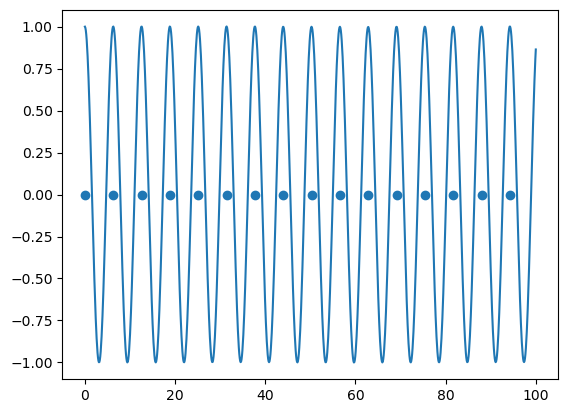

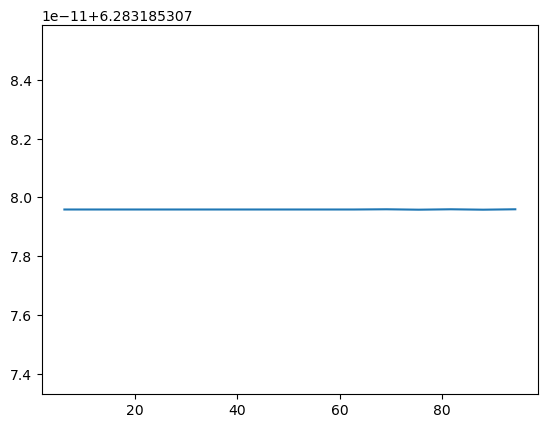

time frequency of single vdp x signal 0.1591549430918953 and delta t 6.283185307179588


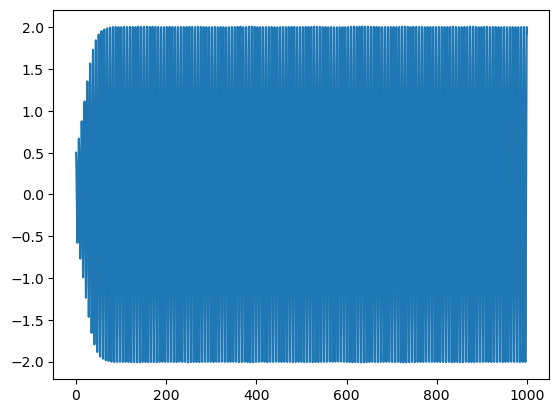

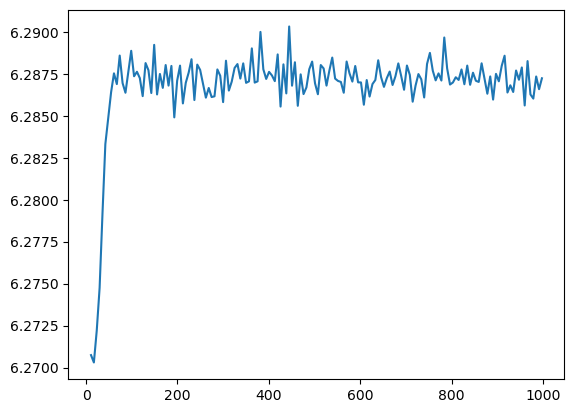

time frequency of single vdp x signal 0.15906617156388056 and delta t 6.286691822455805


In [10]:
def sinusoid(t, x):
    return -np.sin(t)
def event_sinus(t, x):
    dx = sinusoid(t,x)
    return dx
event_sinus.direction = -1

t_sin = np.linspace(0, 100, 1000)
sol_sinus = solve_ivp(sinusoid,
                        [t_start, 100],
                        [1],
                        method="LSODA",
                        dense_output=True,
                        t_eval=t_sin,
                        events=[event_sinus])

plt.plot(sol_sinus.t, sol_sinus.y[0])
plt.scatter(sol_sinus.t_events[0], [0 for e in sol_sinus.t_events[0]])
plt.show()

sin_max = sol_sinus.t_events[0]
peak2p_sin = np.zeros(len(sin_max)-1)
for i in range(len(sin_max)-1):
    peak2p_sin[i] = sin_max[i+1] - sin_max[i]

plt.plot(sin_max[1:], peak2p_sin, label="$x$ $\Delta t$ crête à crête")
plt.show()
print(f"time frequency of single vdp x signal {1/np.mean(peak2p_sin[-5:])} and delta t {np.mean(peak2p_sin[-5:])}")



sol_simple = solve_ivp(vdp_deriv,
                        [t_start, t_stop],
                        [0.5, 0],
                        args=[EPSILON],
                        method="LSODA",
                        dense_output=True,
                        t_eval=t,
                        events=[event_vdp])
t = sol_simple.t
x, y = sol_simple.y
plt.plot(t, x)
plt.show()

x_max = sol.t_events[0]
peak2p = np.zeros(len(x_max)-1)
for i in range(len(x_max)-1):
    peak2p[i] = x_max[i+1] - x_max[i]

plt.plot(x_max[1:], peak2p, label="$x$ $\Delta t$ crête à crête")
plt.show()
print(f"time frequency of single vdp x signal {1/np.mean(peak2p[-5:])} and delta t {np.mean(peak2p[-5:])}")

Using FFT to find frequency of signal



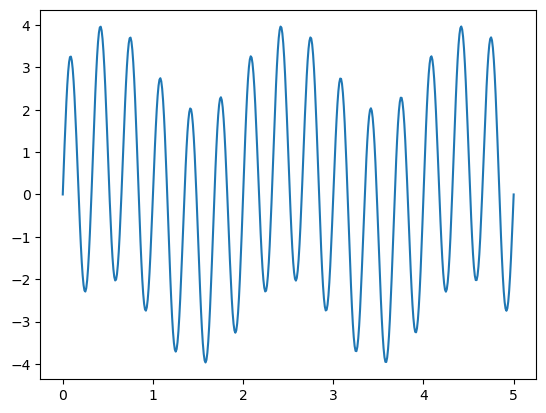

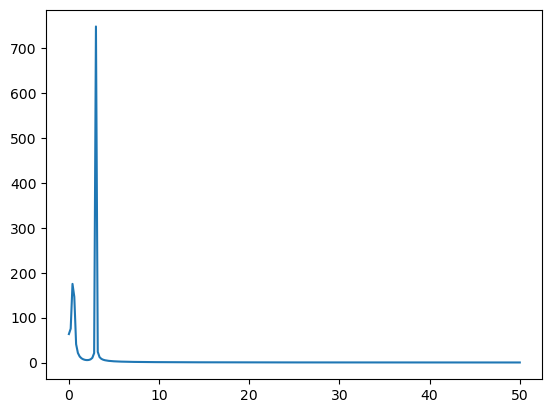

Amplitude for 0.0 : 63.52940671491771
Amplitude for 0.2 : 75.57249160608252
Current max 0.0 with amplitude 63.52940671491771
New max 0.2 with amplitude 75.57249160608252
Amplitude for 0.4 : 175.22162728837597
Current max 0.2 with amplitude 75.57249160608252
New max 0.4 with amplitude 175.22162728837597
Amplitude for 0.6000000000000001 : 146.29093546468874
Amplitude for 0.8 : 40.99742830345076
Amplitude for 1.0 : 21.31579242972176
Amplitude for 1.2000000000000002 : 13.48324669721566
Amplitude for 1.4000000000000001 : 9.495873683204513
Amplitude for 1.6 : 7.2520484341838785
Amplitude for 1.8 : 6.019639401576078
Amplitude for 2.0 : 5.552883902697123
Amplitude for 2.2 : 5.85774214222228
Amplitude for 2.4000000000000004 : 7.199333972574227
Amplitude for 2.6 : 10.56933069974677
Amplitude for 2.8000000000000003 : 21.179237604507485
Amplitude for 3.0 : 748.1338278747535
Current max 0.4 with amplitude 175.22162728837597
New max 3.0 with amplitude 748.1338278747535
Amplitude for 3.2 : 23.9924921

In [25]:

DURATION = 5
SAMPLE_RATE = 100
freq = 3 #Hz
test_t = np.linspace(0, DURATION, DURATION*SAMPLE_RATE)
sig1 = 3*np.sin(3*(2*np.pi)*test_t)
sig2 = np.sin(0.5*(2*np.pi)*test_t)

test_sig = sig1 + sig2
plt.plot(test_t, test_sig)
plt.show()

yf = rfft(test_sig)
xf = rfftfreq(DURATION*SAMPLE_RATE, 1 / SAMPLE_RATE)

plt.plot(xf, np.abs(yf))
plt.show()


for i in range(len(yf)):
    print(f"Amplitude for {xf[i]} : {np.abs(yf[i])}")
    if np.abs(yf[i]) > np.abs(yf[maxIndex]):
        print(f"Current max {xf[maxIndex]} with amplitude {np.abs(yf[maxIndex])}")
        print(f"New max {xf[i]} with amplitude {np.abs(yf[i])}")
        maxIndex = i

print(xf)
print(f"The signal has a frequency of {xf[maxIndex]} Hz")
    

In [ ]:
N_CELLS = 100
#y0_space = np.linspace(-5, 5, N_CELLS)
#x0_space = np.linspace(-5, 5, N_CELLS)
EPS = 0.1
K = 0.1
# make data
x0_space, y0_space = np.meshgrid(np.linspace(-5, 5, N_CELLS), np.linspace(-5, 5, N_CELLS))
phi = np.array((N_CELLS, N_CELLS))


for i in range(N_CELLS):
    for j in range(N_CELLS):
        sol = solve_ivp(coupled_vdp_deriv,
                        [t_start, t_stop],
                        X0[i],
                        args=[EPSILON, kappa],
                        method="LSODA",
                        dense_output=True)
        phi[i, j]



